In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from tqdm.autonotebook import tqdm
from joblib import Parallel, delayed
import umap
import pandas as pd

/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/tqdm/autonotebook/__init__.py:14: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  " (e.g. in jupyter console)", TqdmExperimentalWarning)


In [3]:
from avgn.utils.paths import DATA_DIR, most_recent_subdirectory, ensure_dir
from avgn.visualization.spectrogram import draw_spec_set
from avgn.utils.buckeye_utils import VOWEL_CONSONANT
from avgn.signalprocessing.create_spectrogram_dataset import flatten_spectrograms


In [13]:
from avgn.visualization.projections import scatter_spec
from avgn.utils.general import save_fig
from avgn.utils.paths import FIGURE_DIR, ensure_dir

### load data

In [4]:
DATASET_ID = 'buckeye'

In [6]:
embedding_dict = {}

for cat in ['consonants', 'vowels']:
    embedding_dict[cat] = {}
    for phone_group in tqdm(VOWEL_CONSONANT[cat].keys()):
        save_loc = DATA_DIR / 'syllable_dfs' / DATASET_ID /  'embeddings' / (cat + '_' + phone_group + '.pickle')
        embedding_dict[cat][phone_group] = pd.read_pickle(save_loc)

In [72]:
mean_specs_df =  pd.read_pickle(DATA_DIR / 'syllable_dfs' / DATASET_ID / 'phones_mean.pickle')

In [73]:
mean_specs_df[:3]

,ah,ih,n,s,eh,t,iy,r,k,l,...,en,uh,sh,aw,ch,jh,el,em,zh,own
0,"[[0.4247671890689864, 0.44366481019570325, 0.4...","[[0.4487310393507725, 0.4658653849146514, 0.48...","[[0.6089430345171808, 0.6293126609842211, 0.64...","[[0.39133156074041925, 0.40924441466665556, 0....","[[0.4058770532318084, 0.42614768451371915, 0.4...","[[0.4140381810812835, 0.42679419097007304, 0.4...","[[0.4907670509480515, 0.5148469261591413, 0.53...","[[0.4207396366496286, 0.4352143141695627, 0.44...","[[0.4446645572126484, 0.46262515433932244, 0.4...","[[0.4338201177109475, 0.4476989166761143, 0.46...",...,"[[0.4873954965738874, 0.511441416816685, 0.531...","[[0.45182674126453287, 0.4695456782448742, 0.4...","[[0.36843022589152397, 0.3875846478942423, 0.3...","[[0.40703641002408186, 0.4382468187923721, 0.4...","[[0.32152404540763563, 0.3391331269349847, 0.3...","[[0.4018901527461815, 0.42033582493771177, 0.4...","[[0.4190174791267525, 0.4447200737955008, 0.46...","[[0.44870031928855364, 0.47966282083929007, 0....","[[0.5100726288529316, 0.5321845123352217, 0.54...","[[0.5005949764061072, 0.5259708666725291, 0.53..."


### make plots of different phoneme categories

In [7]:
embedding_dict[cat][phone_group][:3]

,start_time,end_time,labels,word,utterance_number,position_in_utterance,position_in_word,word_number,indv,indvi,age,sex,key,rate,spectrogram,embedding
8,25.307442,25.461083,er,over,8,3,2,3,s25,0,o,f,s2501b,16000,"[[136, 160, 160, 163, 165, 168, 165, 164, 164,...","[2.7119128704071045, -2.6757278442382812]"
81,32.357823,32.547882,er,over,9,3,2,3,s25,0,o,f,s2501b,16000,"[[227, 235, 238, 237, 235, 231, 230, 227, 225,...","[2.0563886165618896, -2.3490538597106934]"
99,34.308480,34.414322,er,over,27,10,2,10,s25,0,o,f,s2501b,16000,"[[209, 212, 217, 221, 226, 232, 237, 240, 241,...","[2.4156322479248047, -2.620695114135742]"


In [ ]:
cpal = 'Set1'

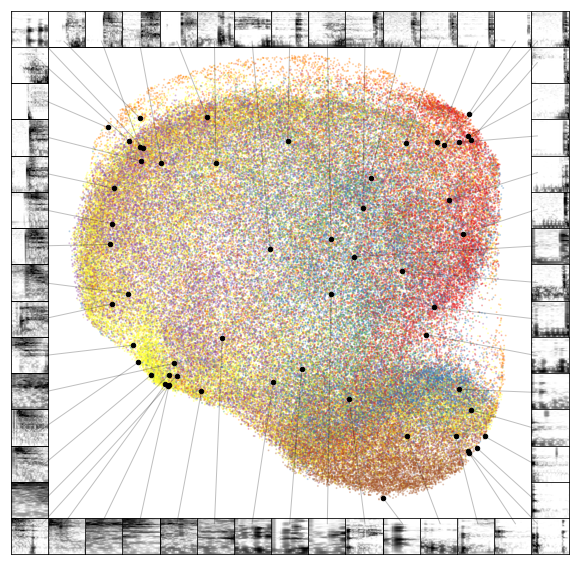

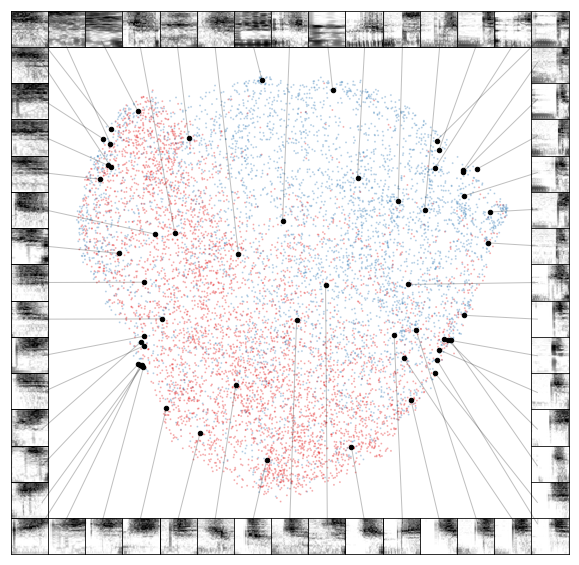

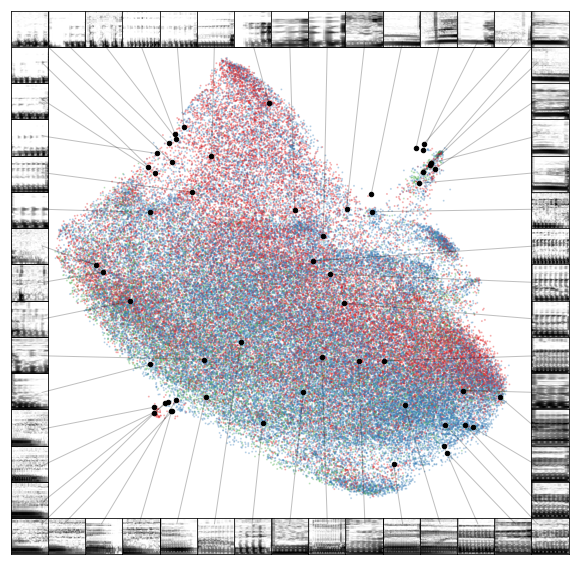

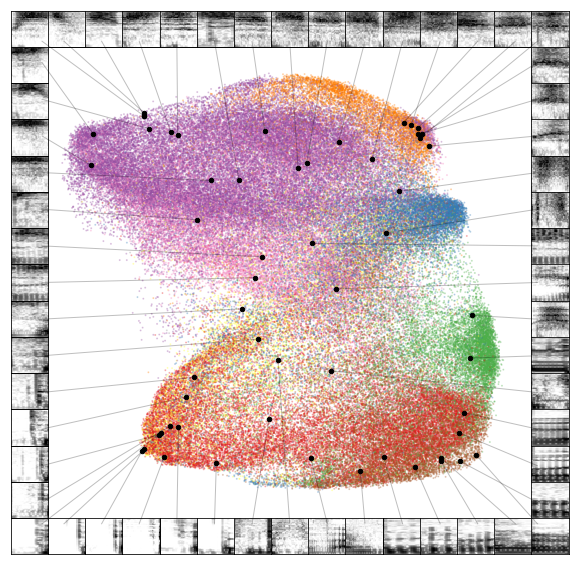

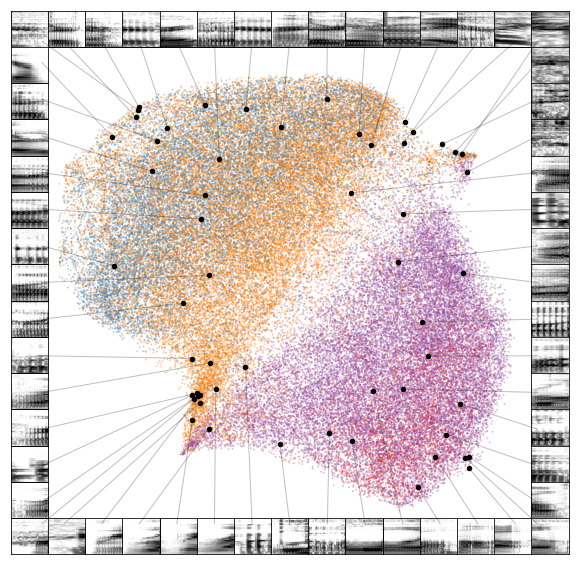

...

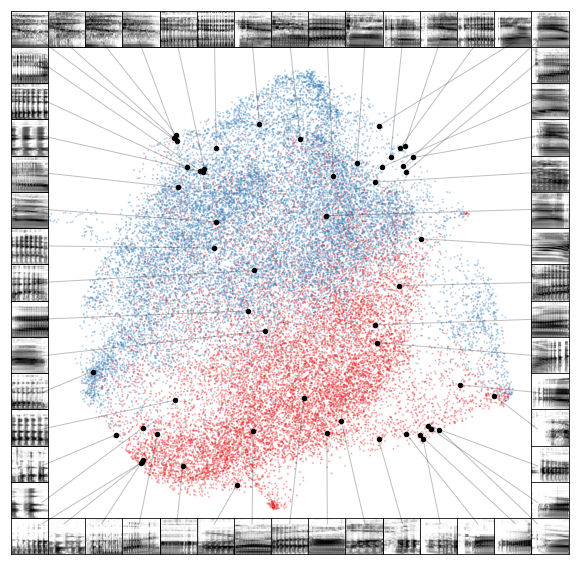

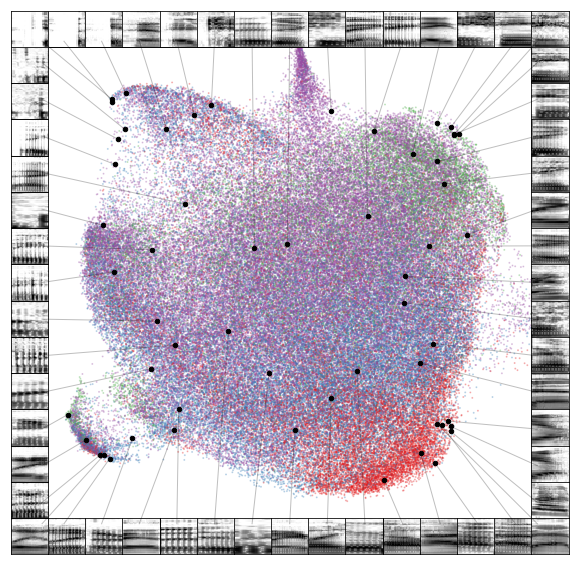

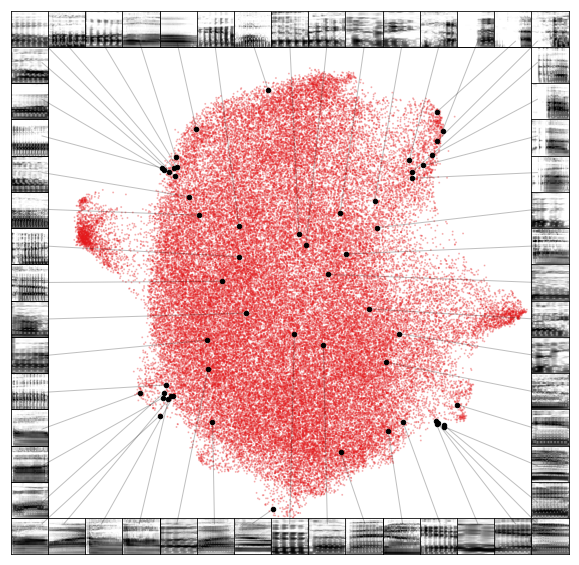

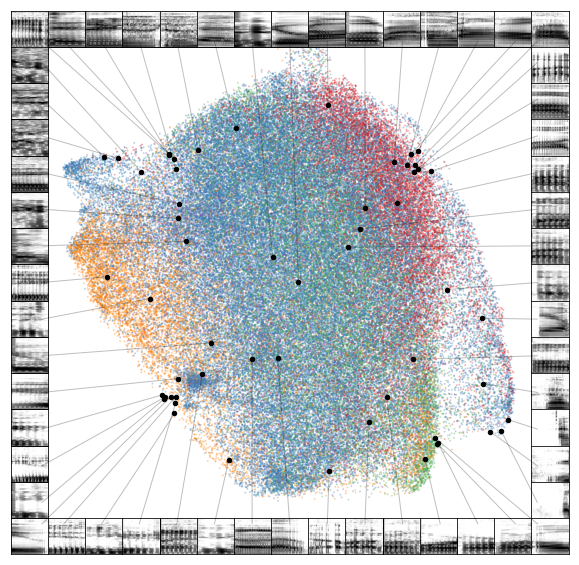

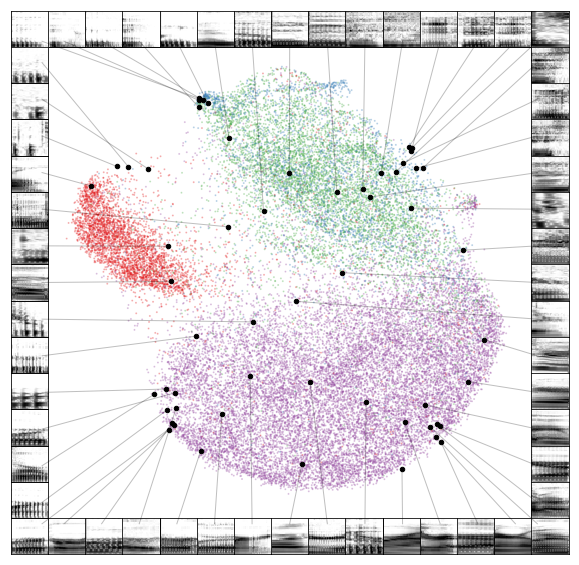

In [41]:
for cat in ['consonants', 'vowels']:
    for phone_group in tqdm(VOWEL_CONSONANT[cat].keys()):
        z = np.vstack(embedding_dict[cat][phone_group].embedding.values)
        labels = embedding_dict[cat][phone_group].labels.values
        specs = np.array(list(embedding_dict[cat][phone_group].spectrogram.values))
        
        scatter_spec(
            np.vstack(z),
            specs,
            column_size=15,
            #x_range = [-5.5,7],
            #y_range = [-10,10],
            pal_color="hls",
            color_points=False,
            enlarge_points=20,
            figsize=(10, 10),
            scatter_kwargs = {
                'labels': list(labels),
                'alpha':0.25,
                's': 1,
                'show_legend': False,
                'color_palette': cpal,
            },
            matshow_kwargs = {
                'cmap': plt.cm.Greys
            },
            line_kwargs = {
                'lw':1,
                'ls':"solid",
                'alpha':0.25,
            },
            draw_lines=True
        );


        #save_fig(FIGURE_DIR / 'bf' / ('bf_sober_'+indv), dpi=300, save_jpg=True)
        plt.show()


In [42]:
cpal = 'hls'

In [43]:
import seaborn as sns

In [62]:
for cat in ['consonants', 'vowels']:
    for phone_group in tqdm(VOWEL_CONSONANT[cat].keys()):
        z = np.vstack(embedding_dict[cat][phone_group].embedding.values)
        alpha = np.min([np.max([1 - (len(z) / 200000), 0.001]), 1])
        print(np.log(len(z)), len(z), alpha)
        

11.821446392354721 136141 0.319295
9.135077887475635 9275 0.953625
11.353132229156781 85232 0.57384
11.795710566809303 132682 0.33658999999999994
11.280577179776333 79267 0.603665
10.470929776721015 35275 0.823625
11.308186505332124 81486 0.59257
12.549921181668651 282073 0.001
11.00401467340901 60115 0.699425
9.39357817555449 12011 0.939945


11.024431946410647 61355 0.693225
11.127395328341542 68009 0.6599550000000001
12.176654133447505 194202 0.02898999999999996
11.643567687960724 113956 0.43022000000000005
11.65344364306619 115087 0.42456499999999997
10.409340834675561 33168 0.83416
11.7958914340683 132706 0.33647000000000005
11.161877516896627 70395 0.6480250000000001
11.69677918074226 120184 0.39908
10.342645301610762 31028 0.8448599999999999


In [113]:
import matplotlib.patheffects as PathEffects


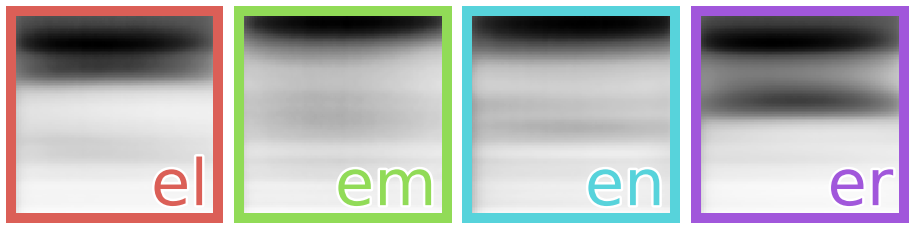

array([1.  , 0.68, 1.  ])

['l', 'er', 'r', 'el']

In [142]:
ensure_dir(FIGURE_DIR / 'phones')

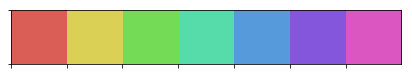

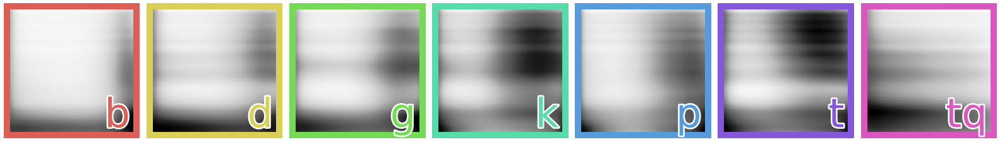

11.821446392354721 136141 0.319295


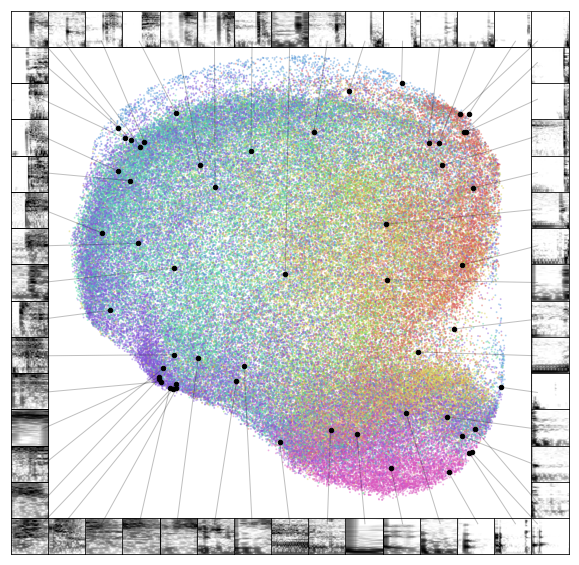

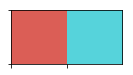

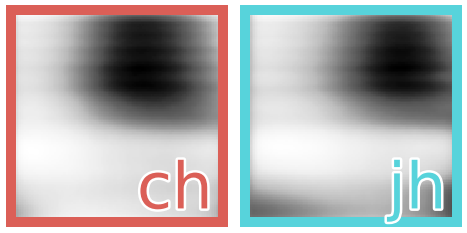

9.135077887475635 9275 0.953625


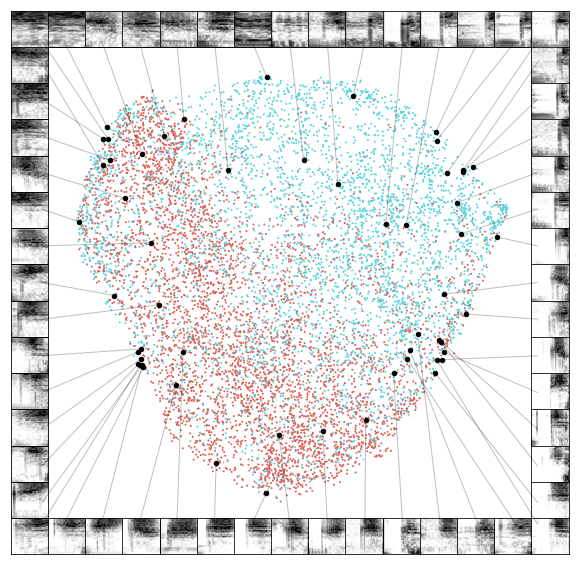

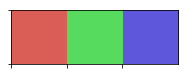

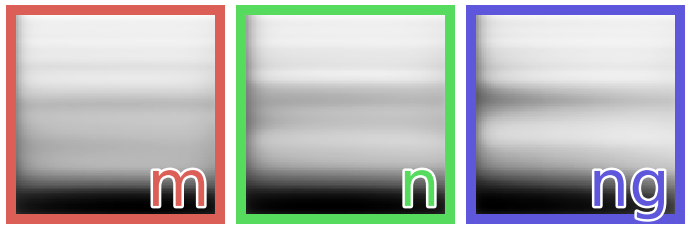

11.353132229156781 85232 0.57384


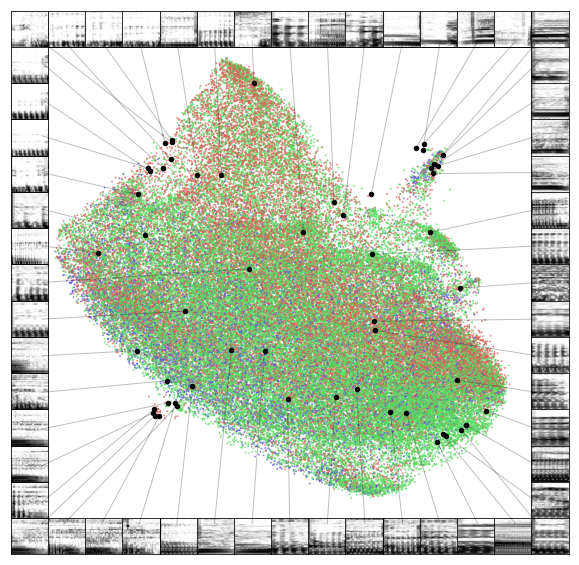

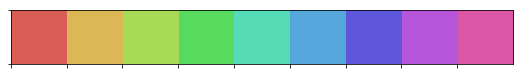

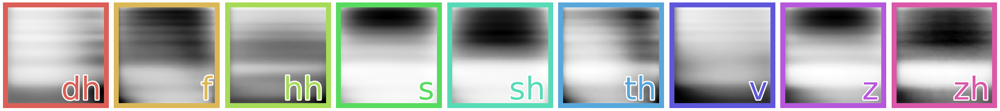

11.795710566809303 132682 0.33658999999999994


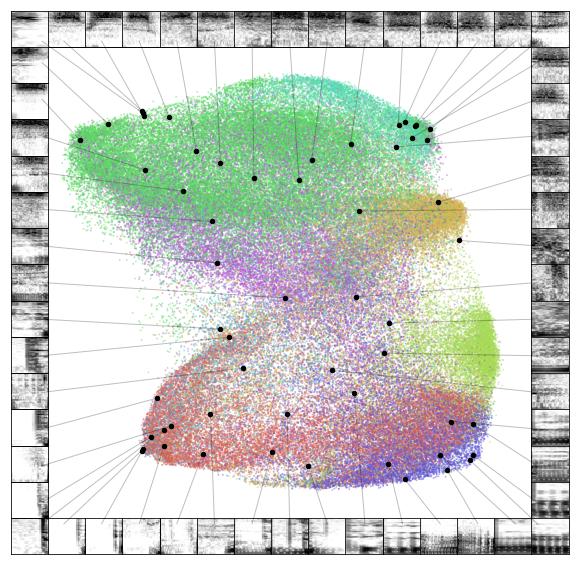

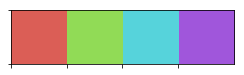

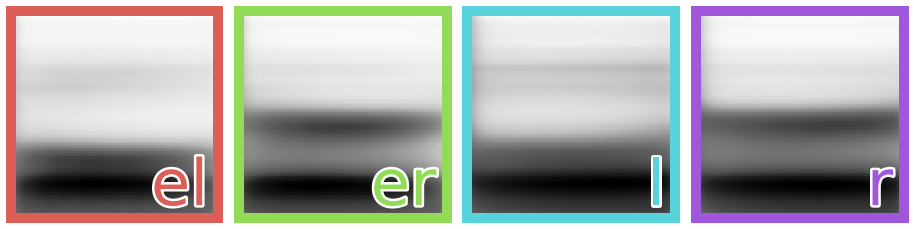

11.28052671614168 79263 0.603685


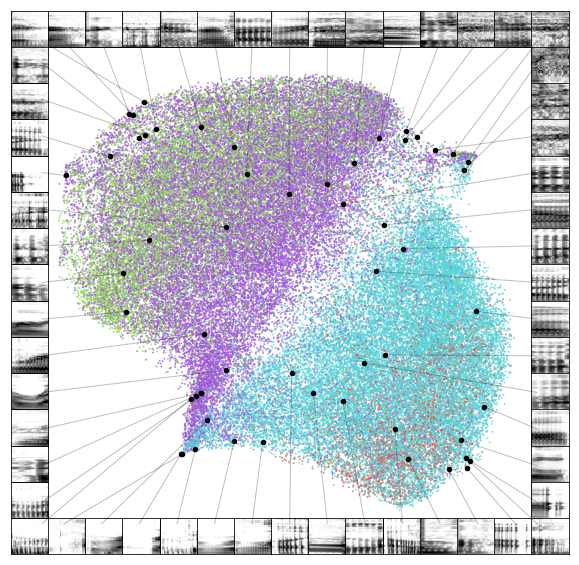

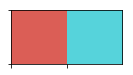

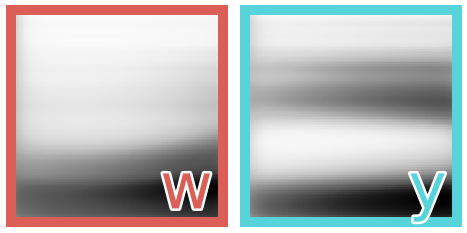

10.470929776721015 35275 0.823625


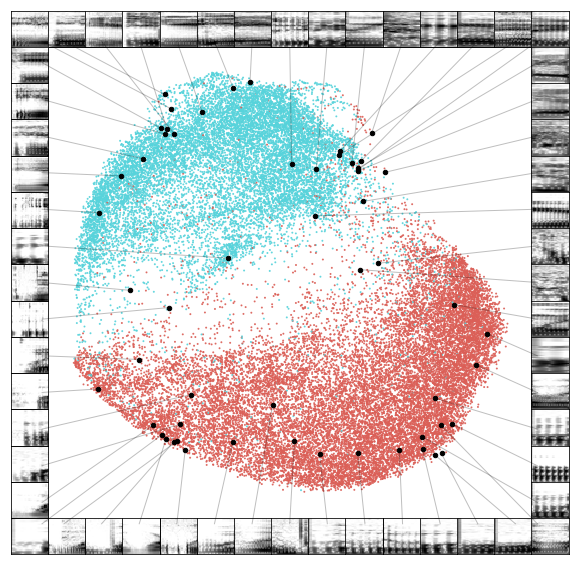

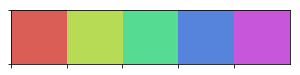

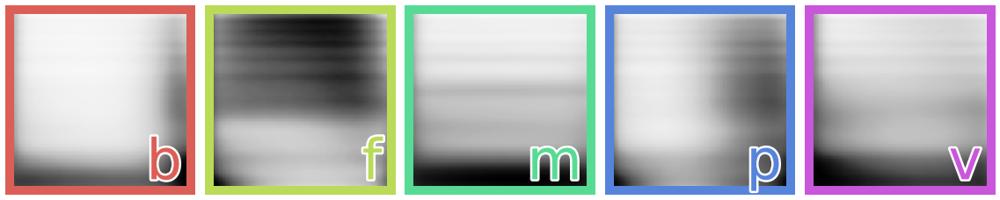

11.308186505332124 81486 0.59257


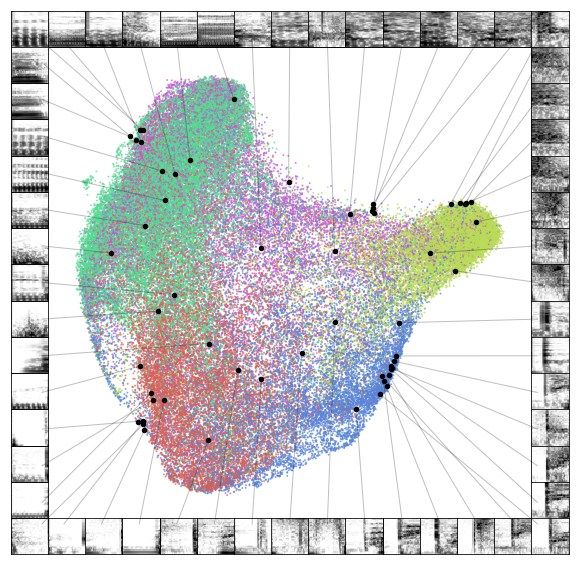

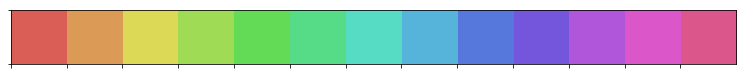

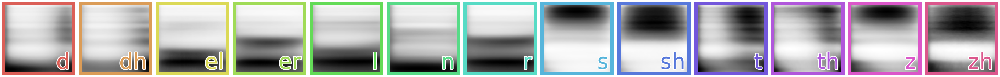

12.549907000841838 282069 0.1


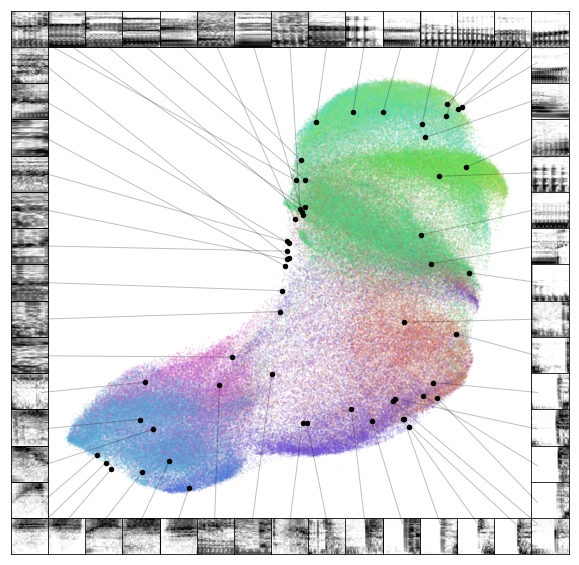

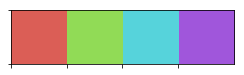

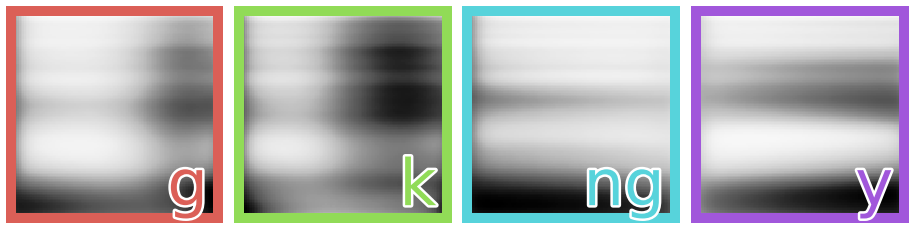

11.00401467340901 60115 0.699425


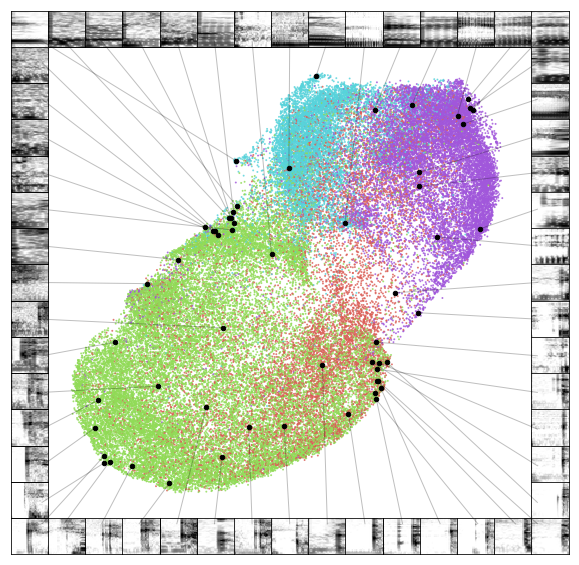

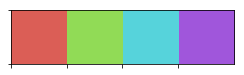

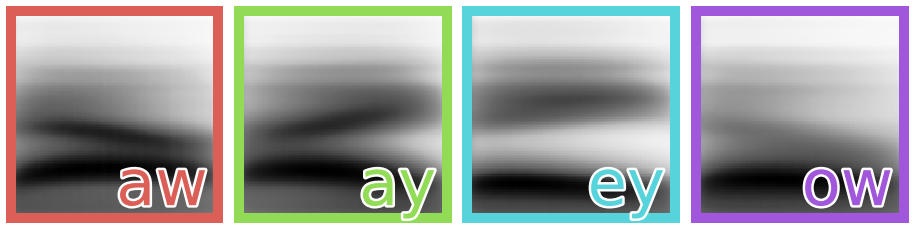

11.015854806436574 60831 0.695845


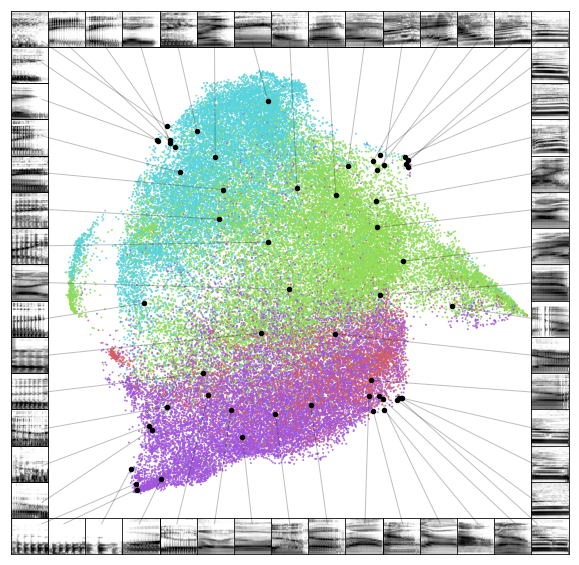

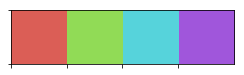

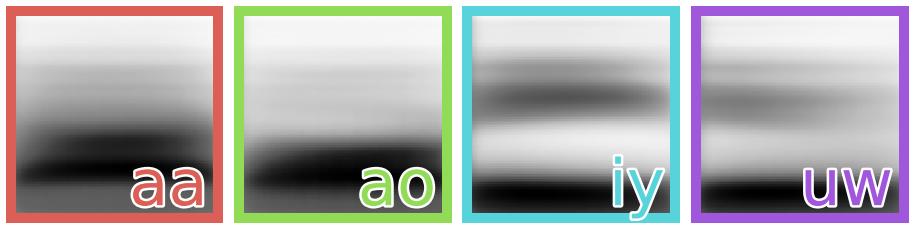

11.127395328341542 68009 0.6599550000000001


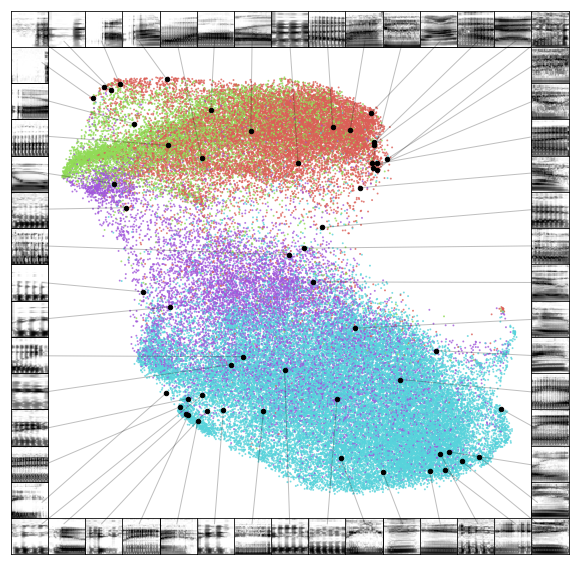

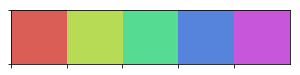

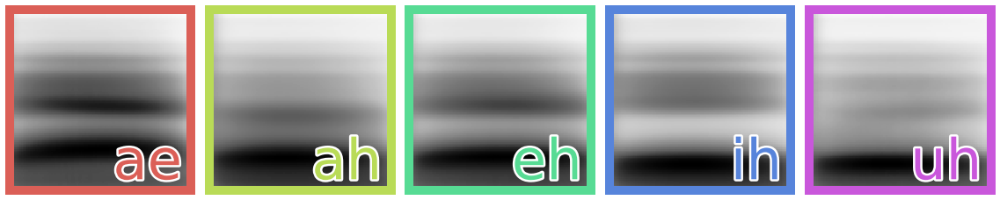

12.176654133447505 194202 0.1


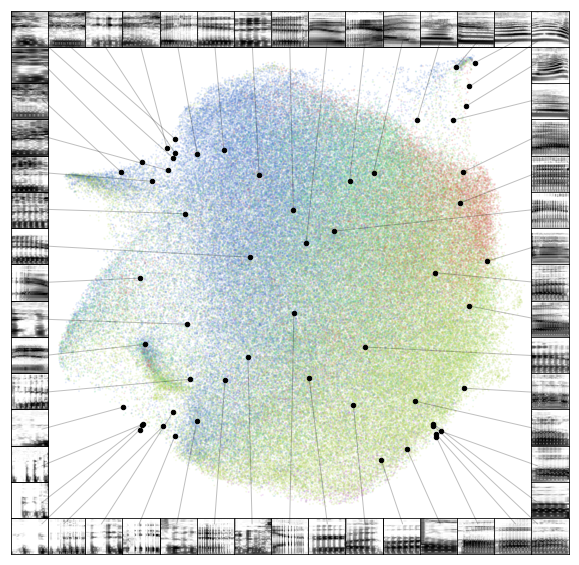

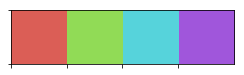

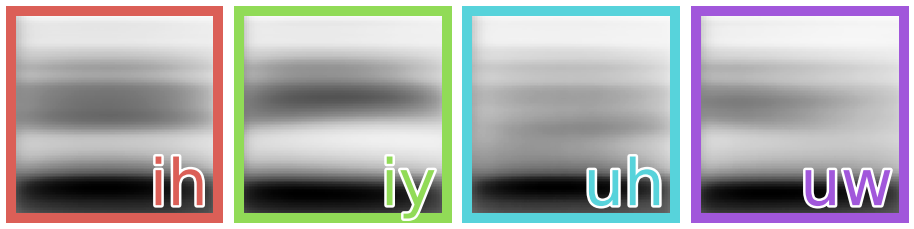

11.643567687960724 113956 0.43022000000000005


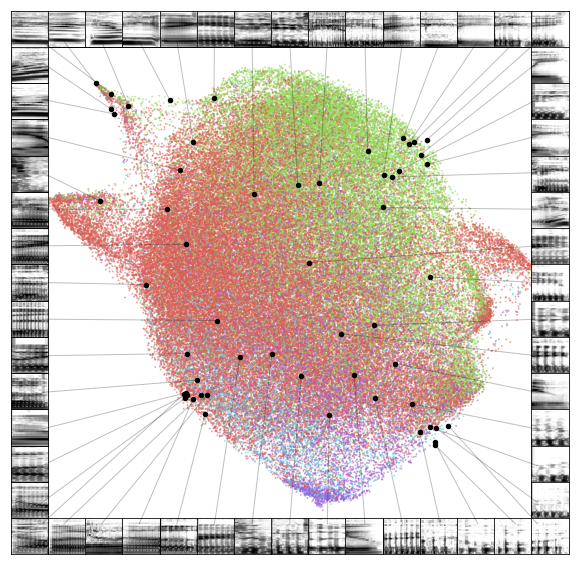

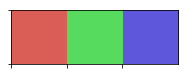

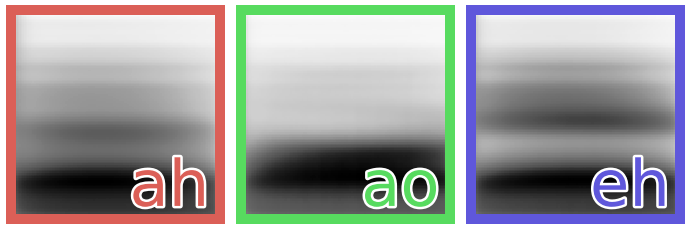

11.65344364306619 115087 0.42456499999999997


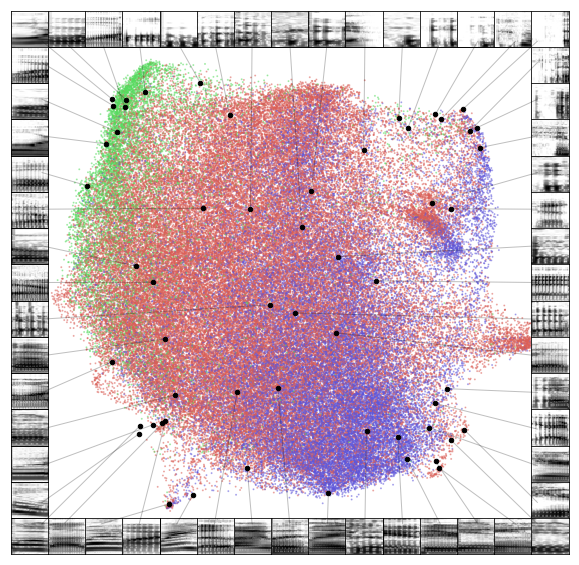

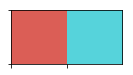

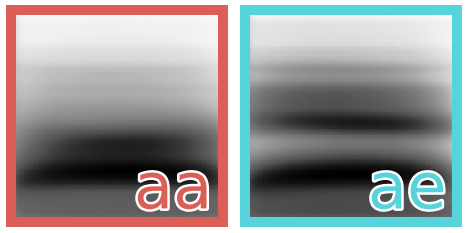

10.409340834675561 33168 0.83416


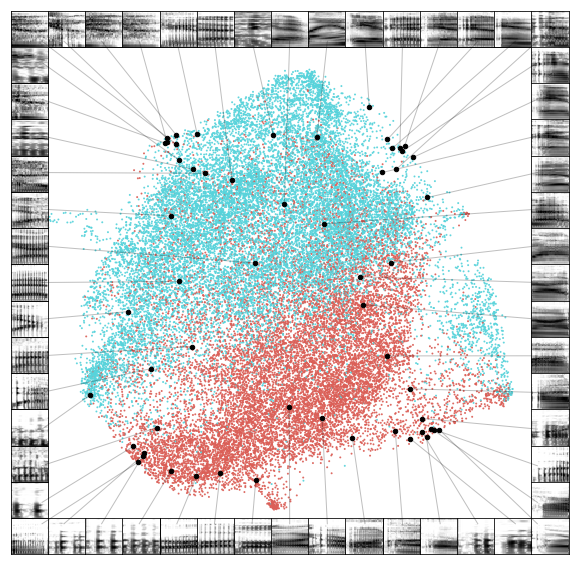

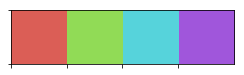

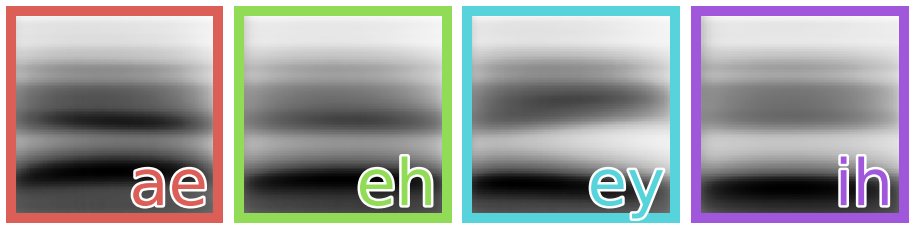

11.7958914340683 132706 0.33647000000000005


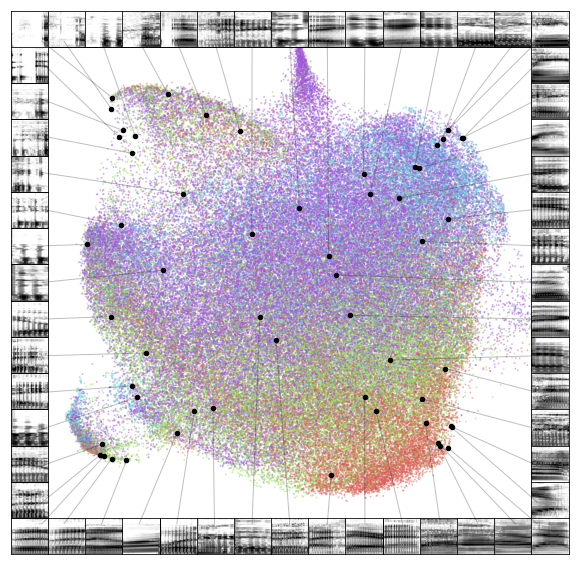

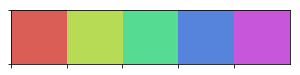

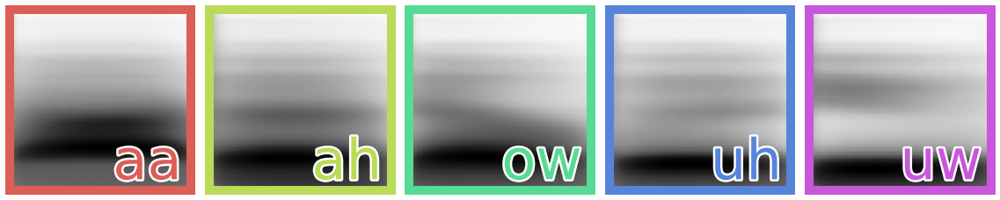

11.69677918074226 120184 0.39908


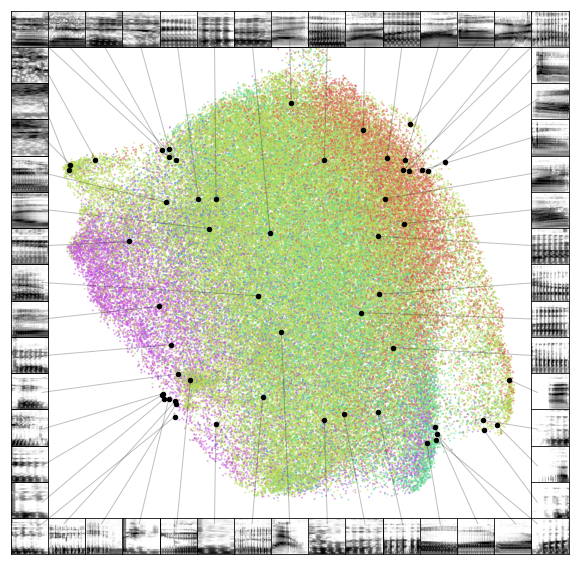

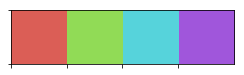

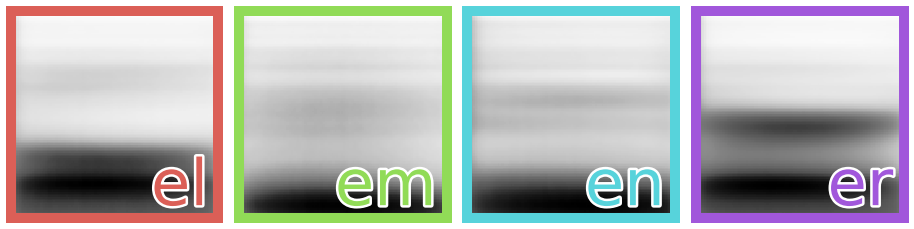

10.342645301610762 31028 0.8448599999999999


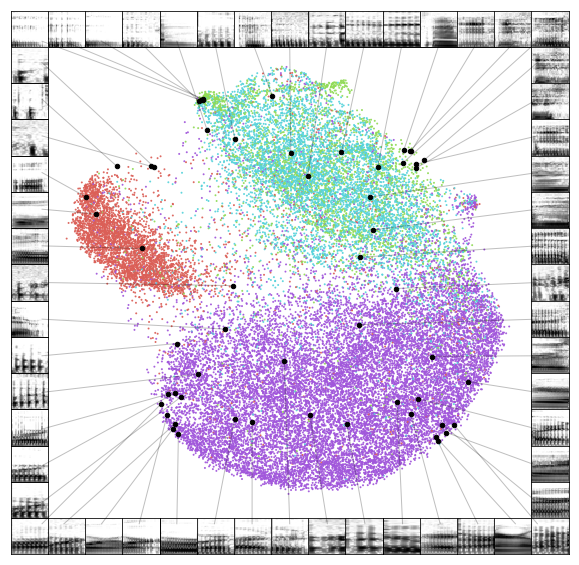

In [143]:
for cat in ['consonants', 'vowels']:
    for phone_group in tqdm(VOWEL_CONSONANT[cat].keys()):
        embed_df = embedding_dict[cat][phone_group]
        lab_mask = [lab for lab in embed_df.labels.unique() if lab  in mean_specs_df.columns]
        if len(lab_mask) <2:
            continue
        embed_df = embed_df[embed_df.labels.isin(lab_mask)]
        
        z = np.vstack(embed_df.embedding.values)
        labels = embed_df.labels.values
        specs = np.array(list(embed_df.spectrogram.values))
        
        
        pal = sns.color_palette(cpal, len(np.unique(labels)))
        sns.palplot(pal)
        
        zoom = 4
        fig, axs = plt.subplots(
            ncols=len(pal),
            figsize=(len(pal) * zoom, zoom),
            gridspec_kw={"wspace": 0.1, "hspace": 0},
        )
        for pi, (lab, pa) in enumerate(zip(np.unique(labels), pal)):
            phone_spec = mean_specs_df[lab].values[0]
            ax = axs[pi]
            ax.matshow(phone_spec, cmap=plt.cm.Greys, origin='lower')
            # ax.axis('off')
            for spine in ax.spines.values():
                spine.set_edgecolor(pa)
                spine.set_linewidth(10)
            ax.get_xaxis().set_ticks([])
            ax.get_yaxis().set_ticks([])
            txt = ax.text(
                0.95,
                0.15,
                lab,
                fontsize=64,
                transform=ax.transAxes,
                color=pa,
                horizontalalignment="right",
                verticalalignment="center",
            )
            txt.set_path_effects([PathEffects.withStroke(linewidth=5, foreground='w')])
            
        save_fig(FIGURE_DIR / 'phones' / (cat + '_' +phone_group + '_labels'), dpi=300, save_jpg=True, save_png=True)
        plt.show()

        alpha = np.min([np.max([1 - (len(z) / 200000), .1]), 1])
        print(np.log(len(z)), len(z), alpha)
        scatter_spec(
            np.vstack(z),
            specs,
            column_size=15,
            #x_range = [-5.5,7],
            #y_range = [-10,10],
            pal_color="hls",
            color_points=False,
            enlarge_points=20,
            figsize=(10, 10),
            scatter_kwargs = {
                'labels': list(labels),
                'alpha':alpha,
                's': 1,
                'show_legend': False,
                'color_palette': cpal,
            },
            matshow_kwargs = {
                'cmap': plt.cm.Greys
            },
            line_kwargs = {
                'lw':1,
                'ls':"solid",
                'alpha':0.25,
            },
            draw_lines=True
        );


        save_fig(FIGURE_DIR / 'phones' / (cat + '_' +phone_group + '_projections'), dpi=300, save_jpg=True, save_png=True)
        plt.show()
        #break
    #break

consonants Plosives


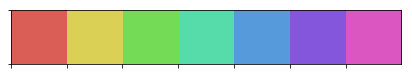

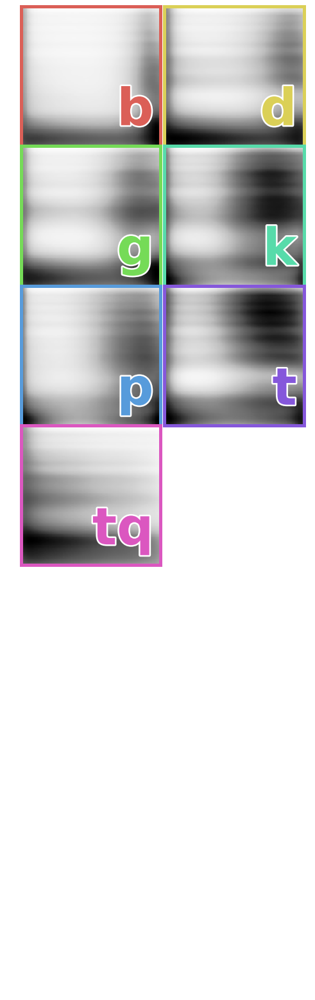

consonants Affricates


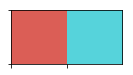

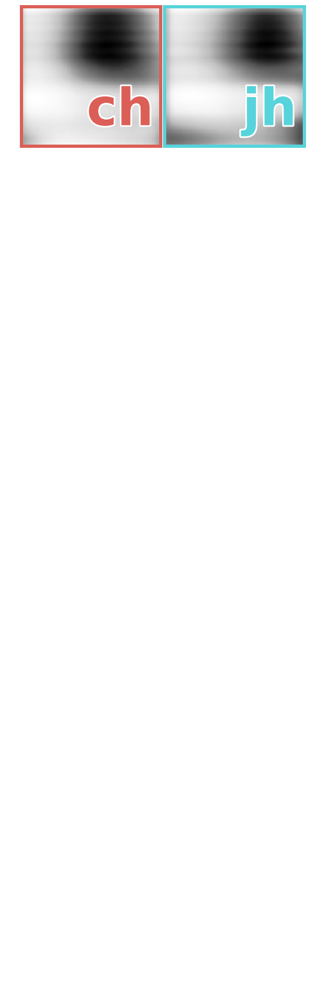

consonants Nasals


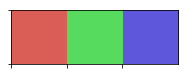

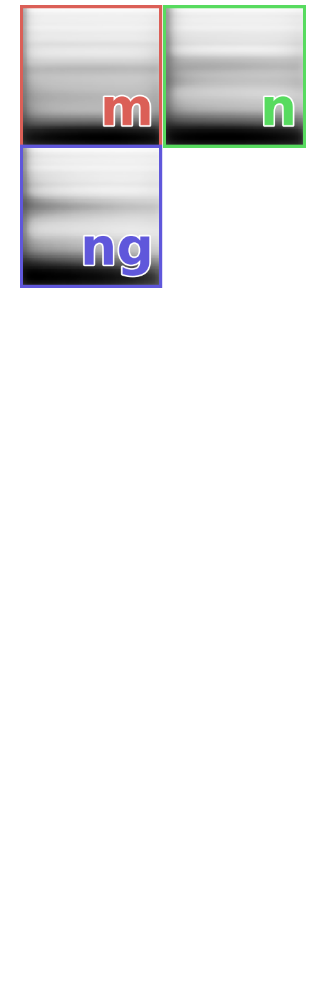

consonants Fricatives


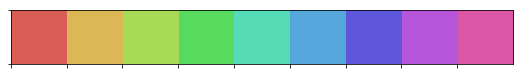

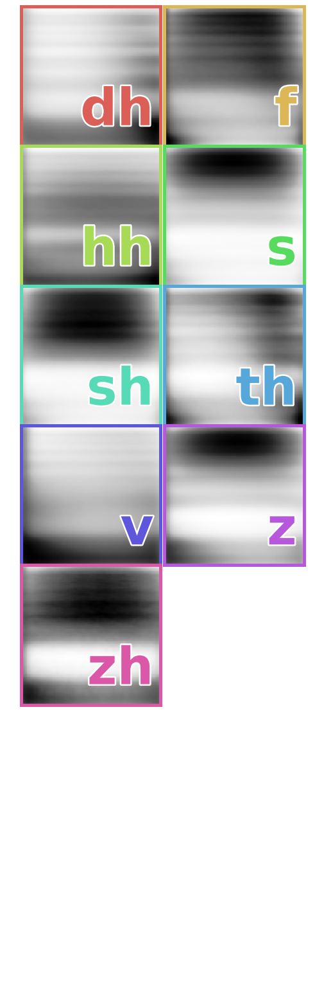

consonants Liquids


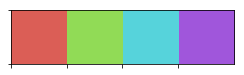

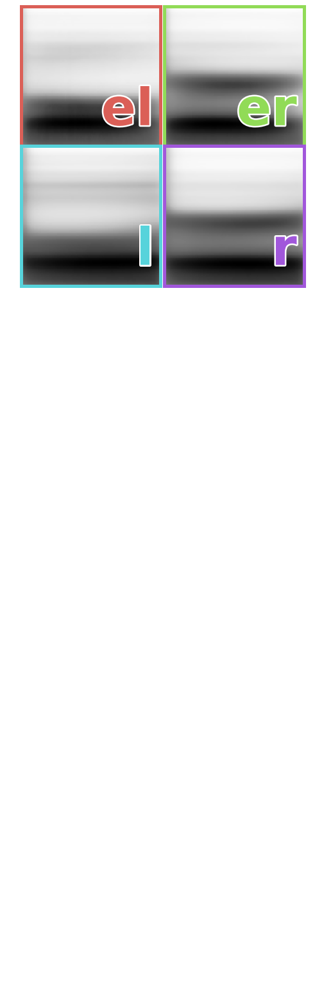

consonants Glides


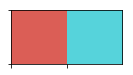

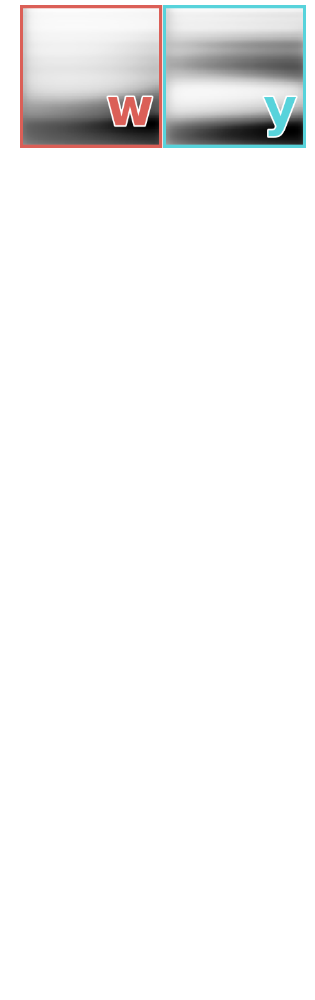

consonants Labials


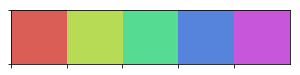

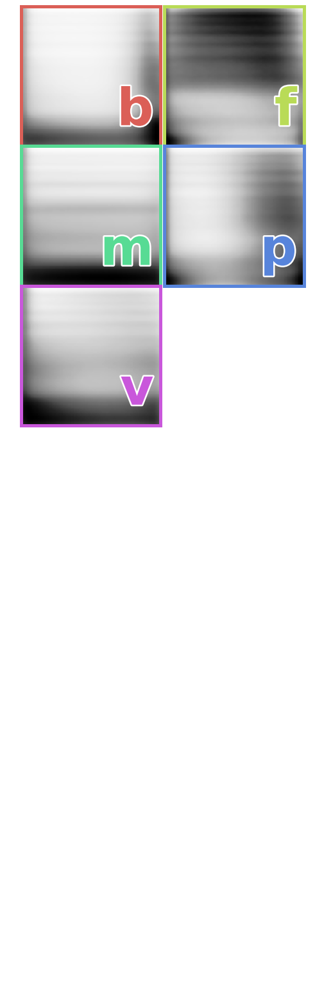

consonants Coronals


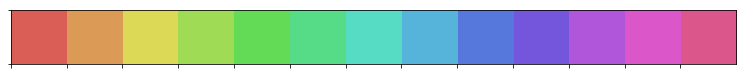

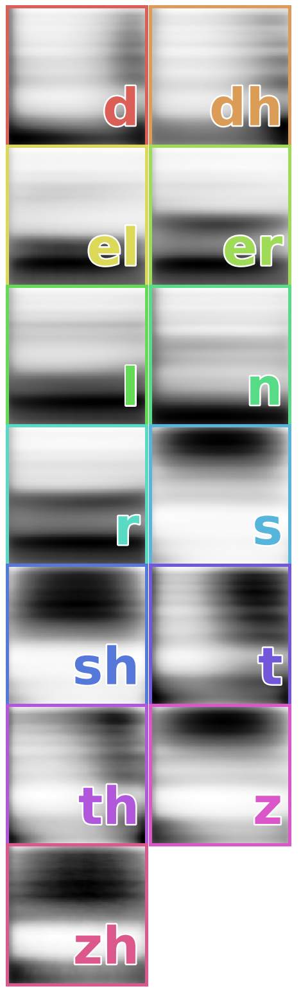

consonants Dorsals


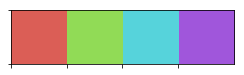

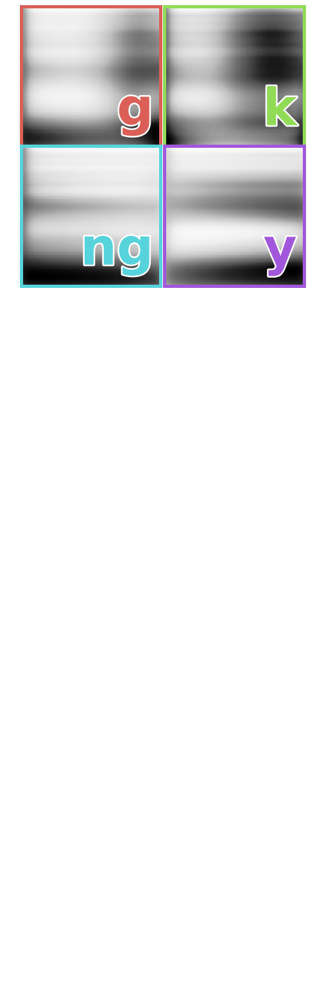

consonants Laryngeals


vowels Diphthong


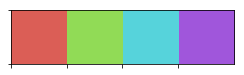

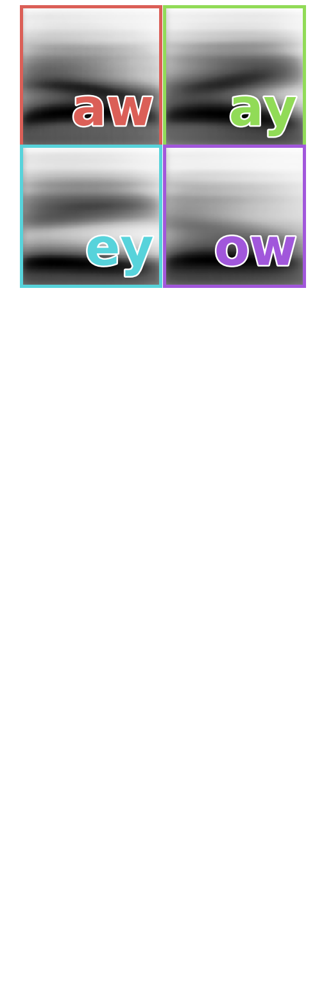

vowels Long vowels


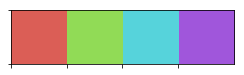

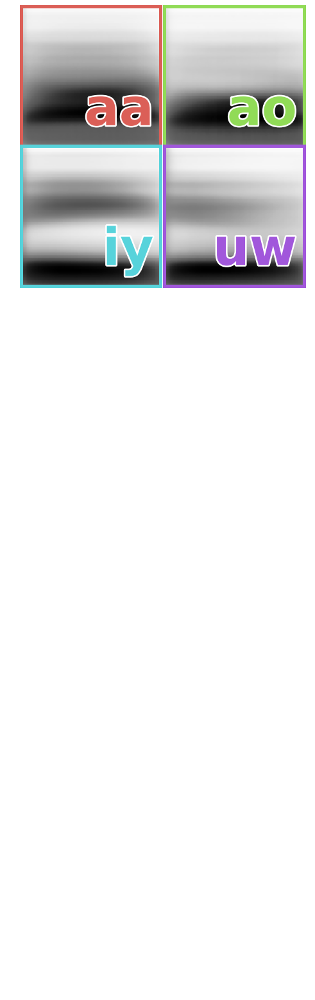

vowels Short vowels


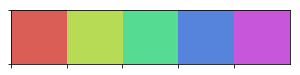

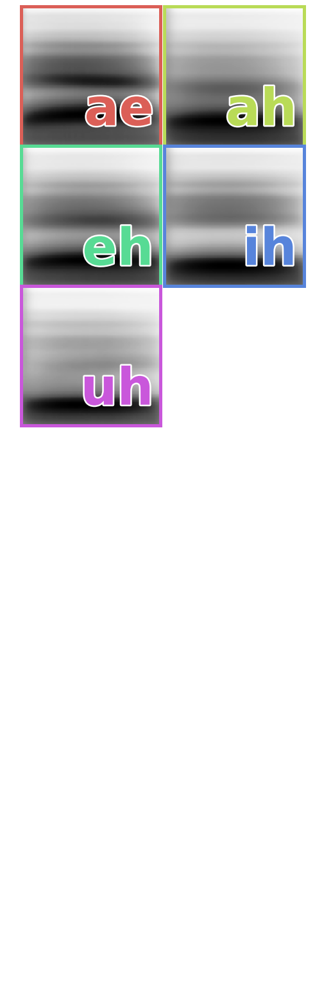

vowels High vowels


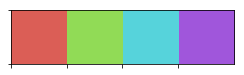

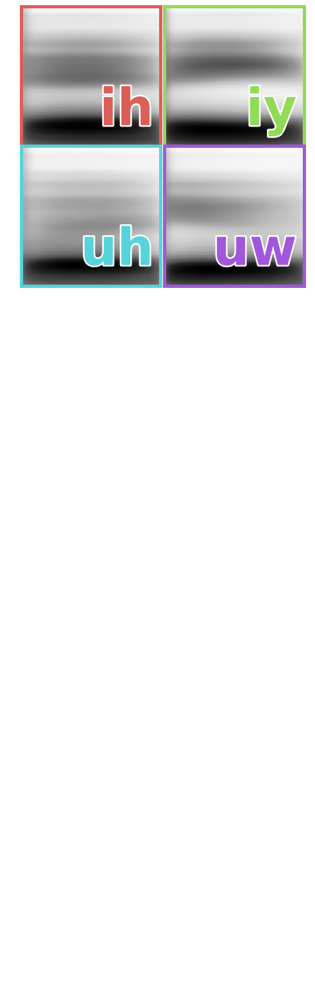

vowels Mid vowels


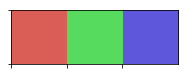

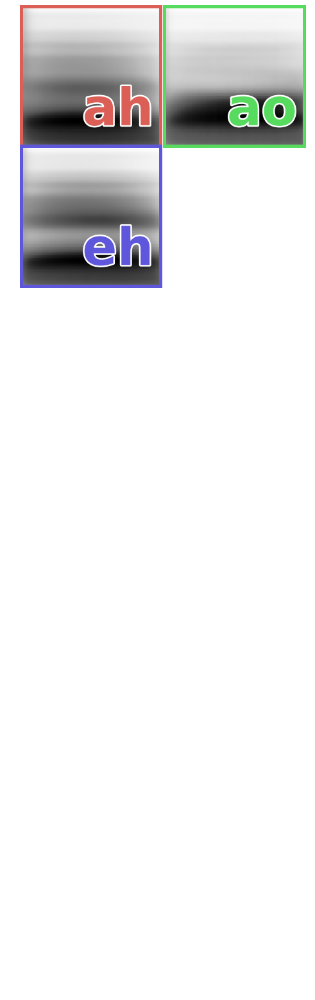

vowels Low vowels


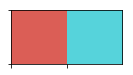

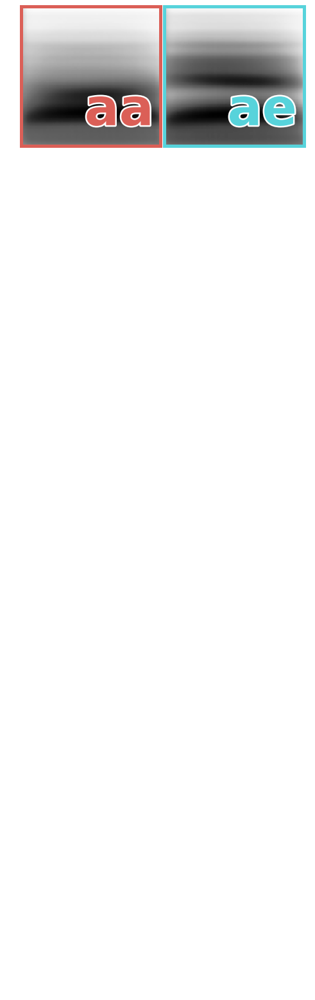

vowels Front vowels


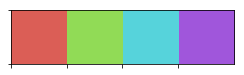

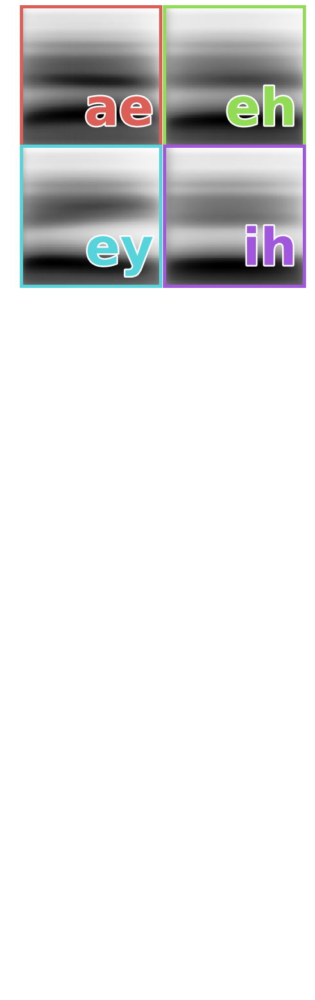

vowels Central vowels
vowels Back vowels


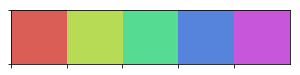

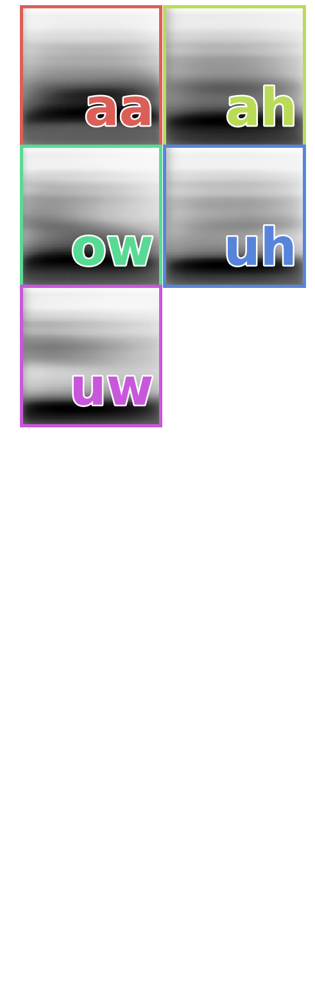

vowels Syllabic consonants


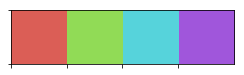

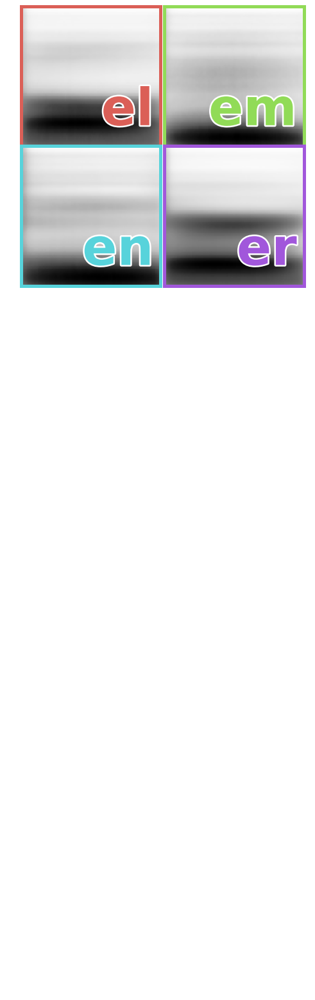

In [205]:
for cat in ['consonants', 'vowels']:
    for phone_group in tqdm(VOWEL_CONSONANT[cat].keys()):
        print(cat, phone_group)
        embed_df = embedding_dict[cat][phone_group]
        lab_mask = [lab for lab in embed_df.labels.unique() if lab  in mean_specs_df.columns]
        if len(lab_mask) <2:
            continue
        embed_df = embed_df[embed_df.labels.isin(lab_mask)]
        
        z = np.vstack(embed_df.embedding.values)
        labels = embed_df.labels.values
        specs = np.array(list(embed_df.spectrogram.values))
        
        
        pal = sns.color_palette(cpal, len(np.unique(labels)))
        sns.palplot(pal)
        
        zoom = 4
        nrows = 7
        ncols = 2
        fig, axs = plt.subplots(
            ncols=ncols,
            nrows=nrows,
            figsize=(ncols * zoom, nrows * zoom),
            gridspec_kw={"wspace": 0.0, "hspace": 0.0},
        )
        for pi, (lab, pa) in enumerate(zip(np.unique(labels), pal)):
            phone_spec = mean_specs_df[lab].values[0]
            ax = axs.flatten()[pi]
            ax.matshow(phone_spec, cmap=plt.cm.Greys, origin="lower")

            # color spines
            for spine in ax.spines.values():
                spine.set_edgecolor(pa)
                spine.set_linewidth(5)
            ax.get_xaxis().set_ticks([])
            ax.get_yaxis().set_ticks([])

            # add text
            txt = ax.text(
                0.95,
                0.25,
                lab,
                fontsize=80,
                transform=ax.transAxes,
                color=pa,
                horizontalalignment="right",
                verticalalignment="center",
                weight="bold"
            )
            #ax.axis('off')
            txt.set_path_effects([PathEffects.withStroke(linewidth=5, foreground="w")])
            #txt.set_path_effects([PathEffects.withStroke(linewidth=5, foreground="k")])

        for ax in axs.flatten()[pi + 1 :]:
            ax.axis("off")

        save_fig(FIGURE_DIR / 'phones' / (cat + '_' +phone_group + '_labels'), dpi=300, save_jpg=True, save_png=True)
        plt.show()
